# Observation

[![Click and Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/metadriverse/metadrive/blob/main/documentation/source/obs.ipynb)


<img align="right" src="figs/observation_demo.png" width=350>

MetaDrive provides various kinds of sensory input, as illustrated in the next figure.
For low-level sensors, RGB cameras, depth cameras, semantic camera, instance camera and Lidar can be placed anywhere in the scene with adjustable
parameters such as view field and the laser number.
Meanwhile, the high-level scene information including the road information and nearby vehicles' information like velocity and heading can also be provided as the observation.

Note that MetaDrive aims at providing an efficient platform to benchmark RL research,
therefore we improve the simulation efficiency at the cost of photorealistic rendering effect.

In this page, we describe the optional observation forms in current MetaDrive version and discuss how to implement new forms of observation subject to your own tasks. There are three kinds of observations we usually used for training agents:
- LidarStateObservation
- ImageStateObservation
- TopDownObservation

By default, the observation is `LidarStateObservation`.

## LidarStateObservation
This observation returns a state vector containing necessary information for navigation tasks.
We use this state vector in almost all existing RL experiments such as the Generalization, MARL and Safe RL experiments.
The state vector consist of three parts:
1. **Ego State**: current states such as the steering, heading, velocity and relative distance to boundaries, implemented in the `vehicle_state` function of [StateObservation](https://github.com/metadriverse/metadrive/blob/main/metadrive/obs/state_obs.py). Please find the detailed meaning of each state dimension in the code.
2. **Navigation**: the navigation information that guides the vehicle toward the destination. Concretely, MetaDrive first computes the route from the spawn point to the destination of the ego vehicle. Then a set of checkpoints are scattered across the whole route with certain intervals. When collecting navigation information, the next two or more checkpoints will be selected and their positions will be projected to the ego vehicle's local coordinates. The final navigation observation consists of these position vectors and other information, i.e. the direction and curvature of the road. This part is implemented in the `_get_info_for_checkpoint` function of [Navigation Class](https://github.com/metadriverse/metadrive/blob/9a89962e72c709e60d4a5bc19ce5f27d96027401/metadrive/component/vehicle_navigation_module/node_network_navigation.py). Note: there are several types of navigation system can be used. Please reference [Navigation](navigation.ipynb) section for more details.
3. **Surrounding**: the surrounding information is encoded by a vector containing the Lidar-like cloud points. The data is generated by the [Lidar Class](https://github.com/metadriverse/metadrive/blob/main/metadrive/component/sensors/lidar.py). We typically use 240 lasers (single-agent) and 70 lasers (multi-agent) to scan the neighboring area with radius 50 meters. Besides, it is optional to include the information of perceived vehicles such as their positions and headings represented in the ego car's local coordinates.

The above information is normalized to [0,1] and concatenated into a state vector by the [LidarStateObservation Class](https://github.com/metadriverse/metadrive/blob/9a89962e72c709e60d4a5bc19ce5f27d96027401/metadrive/obs/state_obs.py) and fed to the RL agents. Now let's dive into the observation class and get you familiar with the state information collection.

## ImageStateObservation


<img align="center" src="figs/rgb_obs.png" width=350>
<img align="center" src="figs/depth_obs.jpg" width=350>

MetaDrive supports visuomotor tasks by rendering 3D scenes during the training.
The above figure shows the images captured by RGB camera (left) and depth camera (right).
By using `ImageStateObservation`, the image data will be returned with **Ego State** and **Navigation** for making the driving decision. In this section, we discuss how to utilize this observation. 

Before using such function in your project, please make sure the offscreen rendering is working in your machine. The setup tutorial is at <a href="install.html#install-metadrive-with-headless-rendering">Install MetaDrive with headless rendering</a>. There are two official examples using RGB camera as observation:
```bash
python -m metadrive.examples.drive_in_single_agent_env --observation rgb_camera

# options for `--camera`: rgb main semantic depth
python -m metadrive.examples.verify_image_observation --camera rgb 
```

Concretely, to setup the vision-based observation, there are three steps:

* Step 1. Set the `config["image_observation"] = True` to tell MetaDrive maintaining a image buffer in memory even no popup window exists.
* Step 2. Notify the simulator what kind of sensor you are going to create in the config. A unique name should be assigned for this sensor. The image size (width and height) will be determined by the camera parameters. 
* Step 3. Set the `config["vehicle_config"]["image_source"]` to the sensor name. Here it should be `rgb_camera`. 

An example creating RGB camera is as follows. It creates an `RGBCamera` with resolution=(width, height)=(128, 64). We then tell the engine to launch the image observation and retrieve the image from sensor whose id name `rgb_camera`. The `image` in the step observation dict `o` actually contains the images of latest several steps. Here we visualize the last image, which is the current frame. How many latest images are included in observation can be specified with config `stack_size`, which is 3 by default.  

In [2]:
from metadrive.envs.metadrive_env import MetaDriveEnv
from metadrive.component.sensors.rgb_camera import RGBCamera
import cv2
from metadrive.policy.idm_policy import IDMPolicy
from IPython.display import Image
from metadrive.utils import generate_gif
import numpy as np
import os
sensor_size = (84, 60) if os.getenv('TEST_DOC') else (200, 100)

cfg=dict(image_observation=True, 
         vehicle_config=dict(image_source="rgb_camera"),
         sensors={"rgb_camera": (RGBCamera, *sensor_size)},
         stack_size=3,
         agent_policy=IDMPolicy # drive with IDM policy
        )

env=MetaDriveEnv(cfg)
frames = []
try:
    env.reset()
    for _ in range(1 if os.getenv('TEST_DOC') else 10000):
        # simulation
        o, r, d, _, _ = env.step([0,1])
        # rendering, the last one is the current frame
        ret=o["image"][..., -1]*255 # [0., 1.] to [0, 255]
        ret=ret.astype(np.uint8)
        frames.append(ret[..., ::-1])
        if d:
            break
    generate_gif(frames if os.getenv('TEST_DOC') else frames[-300:-50])
finally:
    env.close()

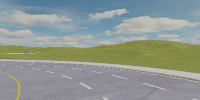

In [41]:
Image(open("demo.gif", 'rb').read(), width=512, height=256)

Besides the newly created `RGBCamera`, there is actually an existing one moving with the car, providing a third person perspective. It is created automatically when launching the rendering service, and captures and renders the content to the main window. Thus the buffer-size for this camera depends on `window_size`. Therefore, you can just use this camera rather than creating a new one. Just set the `image_source=main_camera` and specify the image size with `window_size`. Note that we set `norm_pixel=True` and thus the image pixel value will be unit8 and range from 0 to 255. 

In [ ]:
cfg=dict(image_observation=True, 
         vehicle_config=dict(image_source="main_camera"),
         norm_pixel=False,
         agent_policy=IDMPolicy, # drive with IDM policy
         show_terrain = not os.getenv('TEST_DOC'), # test
         window_size=(84, 60) if os.getenv('TEST_DOC') else (200, 100))

env=MetaDriveEnv(cfg)
frames = []
try:
    env.reset()
    for _ in range(1 if os.getenv('TEST_DOC') else 10000):
        # simulation
        o, r, d, _, _ = env.step([0,1])
        # rendering, the last one is the current frame
        ret=o["image"][..., -1]
        frames.append(ret[..., ::-1])
        if d:
            break
    generate_gif(frames if os.getenv('TEST_DOC') else frames[-300: -50])
finally:
    env.close()

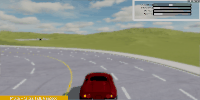

In [39]:
Image(open("demo.gif", 'rb').read(), width=512, height=256)

Rendering images and buffering the image observations consume both the GPU and CPU memory of your machine. Please be careful when using this. If you feel the visual data collection is slow, why not try our advanced offscreen render: <a href="install.html#install-metadrive-with-advanced-offscreen-rendering">Install MetaDrive with advanced offscreen rendering</a>. After verifying your installation, set `config["image_on_cuda"] = True` to get **10x** faster rollout efficiency! It will keep the rendered image on the GPU memory all the time for training, so please ensure your GPU has enough memory to store them. 

More details of how to use sensors is at [Sensors](sensors.ipynb).

### Using semantic camera as observation

{'image': (128, 256, 3, 3), 'state': (19,)}


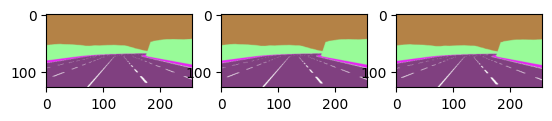

In [1]:
from metadrive.envs import MetaDriveEnv
from metadrive.component.sensors.semantic_camera import SemanticCamera
import matplotlib.pyplot as plt
import os

size = (256, 128) if not os.getenv('TEST_DOC') else (16, 16) # for github CI

env = MetaDriveEnv(dict(
    log_level=50, # suppress log
    image_observation=True,
    show_terrain=not os.getenv('TEST_DOC'),
    sensors={"sementic_camera": [SemanticCamera, *size]},
    vehicle_config={"image_source": "sementic_camera"},
    stack_size=3,
))
obs, info = env.reset()
for _ in range(5):
    obs, r, d, t, i = env.step((0, 1))

env.close()

print({k: v.shape for k, v in obs.items()})  # Image is in shape (H, W, C, num_stacks)

plt.subplot(131)
plt.imshow(obs["image"][:, :, :, 0])
plt.subplot(132)
plt.imshow(obs["image"][:, :, :, 1])
plt.subplot(133)
plt.imshow(obs["image"][:, :, :, 2])

## TopDownObservation
<img align="center" src="figs/top_down_obs.png" width=600>

MetaDrive also supports Top-down semantic maps. We provide a handy example to illustrate the utilization of Top-down observation in [top_down_metadrive.py]( https://github.com/metadriverse/metadrive/blob/main/metadrive/examples/top_down_metadrive.py).
You can enjoy this demo via
```bash
python -m metadrive.examples.top_down_metadrive
```
The following is a minimal script to use Top-down observation.
The `TopDownMetaDrive` is a wrapper class on `MetaDriveEnv` which overrides observation to pygame top-down renderer.
The native observation of this setting is a numpy array with shape `[84, 84, 5]` and all entries fall into [0, 1].
The above figure shows the semantic meaning of each channel.

In [ ]:
from metadrive import TopDownMetaDrive

env = TopDownMetaDrive()
try:
    o,i = env.reset()
    for s in range(1, 100000):
        o, r, tm, tc, info = env.step([0, 1])
        env.render(mode="top_down")
        if tm or tc:
            break
            env.reset()
finally:
    env.close()

## Customization-MultiSensor
We encourage users to design observations according to specific demand. For all environments, the observation of the agent is determined by the function `env.get_single_observation`, which is defined as follows:

In [ ]:
from metadrive.utils import print_source
from metadrive.envs.metadrive_env import MetaDriveEnv
print_source(MetaDriveEnv.get_single_observation)

By default, the observation is `LidarStateObservation`, while `image_observation=True` will change it to `ImageStateObservation`. There are two ways to change the observation class to a customized one. The first way is creating a new environment with the `get_single_observation` overwritten to return your customized observation. `TopDownMetaDrive` is implemented in this way.

In [ ]:
from metadrive.utils import print_source
from metadrive.envs.top_down_env import TopDownMetaDrive, TopDownSingleFrameMetaDriveEnv
print_source(TopDownSingleFrameMetaDriveEnv)
print_source(TopDownMetaDrive)

The second way is specifying the observation class in the field `agent_observation` of the config when creating the environment. The new observation class has to inherit from `BaseObservation` and implement the property `observation_space` (with `@property decorator`) and the function `observe()`. In the following example, we make a customized observation class which collects both vehicle states and images from three types of cameras. 

In [4]:
from metadrive.envs.metadrive_env import MetaDriveEnv
from metadrive.component.sensors.rgb_camera import RGBCamera
from metadrive.component.sensors.semantic_camera import SemanticCamera
from metadrive.component.sensors.depth_camera import DepthCamera
import cv2
import gymnasium as gym
import numpy as np
from metadrive.policy.idm_policy import IDMPolicy
from metadrive.obs.observation_base import BaseObservation
from metadrive.obs.image_obs import ImageObservation
from metadrive.obs.state_obs import StateObservation
import os
sensor_size = (84, 60) if os.getenv('TEST_DOC') else (200, 100)

class MyObservation(BaseObservation):
    def __init__(self, config):
        super(MyObservation, self).__init__(config)
        self.rgb = ImageObservation(config, "rgb", config["norm_pixel"])
        self.depth = ImageObservation(config, "depth", config["norm_pixel"])
        self.semantic = ImageObservation(config, "semantic", config["norm_pixel"])
        self.state = StateObservation(config)

    @property
    def observation_space(self):
        os={o: getattr(self, o).observation_space for o in ["rgb", "state", "depth", "semantic"]}
        return gym.spaces.Dict(os)

    def observe(self, vehicle):
        os={o: getattr(self, o).observe() for o in ["rgb", "state", "depth", "semantic"]}
        return os

After this, we notify the engine to use this observation with the field `agent_observation`. Note we don't need to specify the `cfg['vehicle_config']['image_source']`, as it is used in `ImageStateObservation` which is already overwritten with our customized observation class. In addition, you have to request corresponding sensors so the observation class can find these sensors from the engine. Actually, you are allowed to create any number of sensors according to your demand. All available sensors can be found at <a href="sensors.html">Sensors</a>. At last, the config should look like:

In [6]:
cfg=dict(agent_policy=IDMPolicy, # drive with IDM policy
         agent_observation=MyObservation,
         image_observation=True,
         sensors={"rgb": (RGBCamera, *sensor_size),
                  "depth": (DepthCamera, *sensor_size),
                  "semantic": (SemanticCamera, *sensor_size)},
         log_level=50) # turn off log

Once finishing the setup, the following code will launch the simulation and show you the image observations returned by `env.step()`, which should contain images from three cameras.

In [44]:
from metadrive.utils import generate_gif
from IPython.display import Image

frames = []
env=MetaDriveEnv(cfg)
try:
    env.reset()
    print("Observation shape: \n", env.observation_space)
    for step in range(1 if os.getenv('TEST_DOC') else 1000):
        o, r, d, _, _ = env.step([0,1]) # simulation
        
        # visualize image observation
        o_1 = o["depth"][..., -1]
        o_1 = np.concatenate([o_1, o_1, o_1], axis=-1) # align channel
        o_2 = o["rgb"][..., -1]
        o_3 = o["semantic"][..., -1]
        ret = cv2.hconcat([o_1, o_2, o_3])*255
        ret=ret.astype(np.uint8)
        frames.append(ret[..., ::-1])
        if d:
            break
    generate_gif(frames if os.getenv('TEST_DOC') else frames[-300:-50]) # only show 250 frames
finally:
    env.close()

Observation shape: 
 Dict('depth': Box(-0.0, 1.0, (100, 200, 1, 3), float32), 'rgb': Box(-0.0, 1.0, (100, 200, 3, 3), float32), 'semantic': Box(-0.0, 1.0, (100, 200, 3, 3), float32), 'state': Box(-0.0, 1.0, (19,), float32))


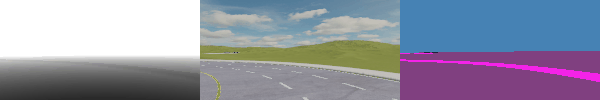

In [45]:
Image(open("demo.gif", 'rb').read(), width=256*3, height=128)

## Customization-MultiView
Usually, you don't need to create a certain type of image sensor multiple times and maintain many instances in the game engine. Instead, you can create just one sensor but mount it to different positions and poses to collect multiple rendering results. In this way, the rendering can be more efficient.

In the following example, we want 4 RGB cameras to monitor the traffic density of 4 entries of an intersection. **In practice, we don't create any new RGB cameras but use the main RGB camera. In every frame, we move it to 4 target positions to collect data.** The result is the same as capturing images with 4 different RGB cameras, which harms the simulation's performance.

More sensor examples can be found in [Sensors](sensors.ipynb).

In [12]:
from metadrive.envs.metadrive_env import MetaDriveEnv
import cv2
import gymnasium as gym
import numpy as np
from metadrive.obs.observation_base import BaseObservation
from metadrive.obs.image_obs import ImageObservation
import os
from metadrive.utils import generate_gif
from IPython.display import Image
sensor_size = (1, 1) if os.getenv('TEST_DOC') else (200, 200)

In [13]:
class MyObservation(BaseObservation):
    def __init__(self, config):
        super(MyObservation, self).__init__(config)
        self.rgb = ImageObservation(config, "main_camera", config["norm_pixel"])

    @property
    def observation_space(self):
        os = {"entry_{}".format(idx): self.rgb.observation_space for idx in range(4)}
        os["top_down"] = self.rgb.observation_space
        return gym.spaces.Dict(os)

    def observe(self, vehicle):
        ret = {}
        # The first rendered image is the top-down view
        ret["top_down"] = self.rgb.observe()
        # The camera can be borrowed to render new images with new poses
        for idx in range(4):
            ret["entry_{}".format(idx)] = self.rgb.observe(self.engine.origin,
                                                           position=[70, 8.75, 8],
                                                           hpr=[idx * 90, -15, 0])
        return ret


env_cfg = dict(agent_observation=MyObservation,
               image_observation=True,
               window_size=sensor_size,
               map="X",
               show_terrain=not os.getenv('TEST_DOC'),
               traffic_density=0.2,
               show_interface=False,
               show_fps=False,
               traffic_mode="respawn",
               log_level=50,  # no log message
               vehicle_config=dict(image_source="main_camera"))


def reset_sensors(self):
    """
    Put the main camera to the center of the intersection at the start of each episode
    """
    self.main_camera.stop_track()
    self.main_camera.set_bird_view_pos([70, 8.75])
    self.main_camera.top_down_camera_height = 50


MetaDriveEnv.reset_sensors = reset_sensors

frames = []
env = MetaDriveEnv(env_cfg)
try:
    env.reset()
    print("Observation shape: \n", env.observation_space)
    for step in range(1 if os.getenv('TEST_DOC') else 500):
        o, r, d, _, _ = env.step([0, -1])  # simulation

        # visualize image observation
        o_1 = o["entry_0"][..., -1]
        o_2 = o["entry_1"][..., -1]
        o_3 = o["entry_2"][..., -1]
        o_4 = o["entry_3"][..., -1]
        o_5 = o["top_down"][..., -1]
        ret = cv2.hconcat([o_1, o_2, o_3, o_4, o_5]) * 255
        ret = ret.astype(np.uint8)
        frames.append(ret[::2, ::2, ::-1])
    generate_gif(frames if os.getenv('TEST_DOC') else frames[-100:])  # only show -100 frames
finally:
    env.close()

Observation shape: 
 Dict('entry_0': Box(-0.0, 1.0, (200, 200, 3, 3), float32), 'entry_1': Box(-0.0, 1.0, (200, 200, 3, 3), float32), 'entry_2': Box(-0.0, 1.0, (200, 200, 3, 3), float32), 'entry_3': Box(-0.0, 1.0, (200, 200, 3, 3), float32), 'top_down': Box(-0.0, 1.0, (200, 200, 3, 3), float32))


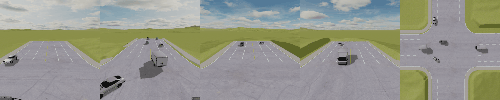

In [10]:
Image(open("demo.gif", 'rb').read(), width=100*5, height=100)

## FAQ

### Can I use LidarState observation but also render the images at the same time?

Yes! You can stick to the original observation by passing `config["agent_observation"]=LidarStateObservation` but still maintaining the RGB camera with `config["sensors"]=dict(rgb_camera=(RGBCamera, ...))`. See this example:

[INFO] Environment: MetaDriveEnv
[INFO] MetaDrive version: 0.4.2.3
[INFO] Sensors: [lidar: Lidar(), side_detector: SideDetector(), lane_line_detector: LaneLineDetector(), rgb_camera: RGBCamera(512, 256)]
[INFO] Render Mode: offscreen
[INFO] Horizon (Max steps per agent): None
[WARNING] You have set norm_pixel = False, which means the observation will be uint8 values in [0, 255]. Please make sure you have parsed them later before feeding them to network! (metadrive_env.py:113)
[INFO] Assets version: 0.4.2.3
[INFO] Known Pipes: glxGraphicsPipe
[INFO] Assets version: 0.4.2.3
[INFO] Known Pipes: glxGraphicsPipe
[WARNING] You are using too large buffer! The height is 256, and width is 512. It may lower the sample efficiency! Consider reducing buffer size or use cuda image by set [image_on_cuda=True]. (base_camera.py:49)
[INFO] Start Scenario Index: 0, Num Scenarios : 1


Observation shape:  (259,)


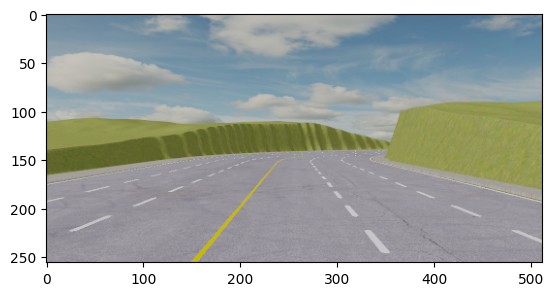

In [1]:
from metadrive.envs.metadrive_env import MetaDriveEnv
from metadrive.obs.state_obs import LidarStateObservation
from metadrive.component.sensors.rgb_camera import RGBCamera
import os
test_doc = os.getenv('TEST_DOC')
sensor_size = (84, 60) if test_doc else (200, 100)

env = MetaDriveEnv(config=dict(
    use_render=False,
    agent_observation=LidarStateObservation,
    image_observation=True,
    norm_pixel=False,
    sensors=dict(rgb_camera=(RGBCamera, *sensor_size)),
))

obs, info = env.reset()

print("Observation shape: ", obs.shape)

image = env.engine.get_sensor("rgb_camera").perceive(to_float=False)
image = image[..., [2, 1, 0]]

if not test_doc:
    import matplotlib.pyplot as plt
    plt.imshow(image)
    plt.show()